# FIN-413 Project

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)


# Useful function to display dataframe + display shape
def disp(df, n=5, title=None):
    if title:
        print(title)
    display(df.head(n))
    print(df.shape)

## Part 1 - Exploratory Data Analysis

### Preliminary considerations

In [2]:
data = pd.read_csv("data.csv", skiprows=[0])

# Parse the 'time' column to datetime if it's not already in that format
data['time'] = pd.to_datetime(data['time'], errors='coerce')

# Convert all other columns to numeric values, assuming they represent returns
for col in data.columns[1:]:
    data[col] = pd.to_numeric(data[col], errors='coerce')

# Set the index
data.set_index("time", drop = True, inplace = True)

# Data overview
print("Data overview")
disp(data)

# Data description
print("Data description")
display(data.info())

# Create list of the names of the crypto / indices
cryptos = ['ADA', 'BCH', 'BTC', 'DOGE', 'ETH', 'LINK', 'LTC', 'MANA', 'XLM', 'XRP']
indices = ['SPXT', 'XCMP', 'USSOC', 'VIX']

# Important dates
datePP = datetime.strptime("2021/09/11", "%Y/%m/%d")
dateTr = datetime.strptime("2022/11/21", "%Y/%m/%d")
dateRec = datetime.strptime("2024/03/07", "%Y/%m/%d")

Data overview


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
time,,,,,,,,,,,,,,
2017-10-02,0.027392,0.008261,-0.000402,-0.023234,-0.023491,-0.181214,-0.027555,-0.203082,-0.062725,-0.024964,0.00388,0.00320,0.00168,-0.00631
2017-10-03,-0.194745,-0.042087,-0.019799,-0.026641,-0.016846,-0.033296,-0.021392,0.166436,-0.045385,0.000985,0.00220,0.00238,0.00126,0.00635
2017-10-04,0.050384,-0.115200,-0.022141,-0.008798,-0.000445,0.134588,-0.017833,-0.144464,-0.048348,0.050172,0.00131,0.00060,0.00501,0.01262
2017-10-05,-0.016903,-0.004159,0.024363,-0.006903,0.011348,0.033163,0.008200,-0.063668,0.226926,0.114754,0.00582,0.00778,0.00624,-0.04569
2017-10-06,-0.140799,0.025370,0.011686,0.016882,0.045222,0.155556,0.008521,-0.398374,0.268461,-0.019328,-0.00076,0.00075,0.00413,0.05005


(2357, 14)
Data description
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2357 entries, 2017-10-02 to 2024-03-15
Data columns (total 14 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ADA     2357 non-null   float64
 1   BCH     2357 non-null   float64
 2   BTC     2357 non-null   float64
 3   DOGE    2357 non-null   float64
 4   ETH     2357 non-null   float64
 5   LINK    2357 non-null   float64
 6   LTC     2357 non-null   float64
 7   MANA    2357 non-null   float64
 8   XLM     2357 non-null   float64
 9   XRP     2357 non-null   float64
 10  SPXT    2357 non-null   float64
 11  XCMP    2357 non-null   float64
 12  USSOC   2357 non-null   float64
 13  VIX     2357 non-null   float64
dtypes: float64(14)
memory usage: 276.2 KB


None

In [3]:
# Descriptive statistics
print("Descriptive statistics")
display(data.describe())

Descriptive statistics


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
count,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000,2357.000000
mean,0.003617,0.002577,0.001889,0.005301,0.002214,0.003892,0.001615,0.005333,0.002936,0.002351,0.000404,0.000485,0.001163,0.002414
std,0.071039,0.078500,0.037976,0.106470,0.047708,0.068262,0.053650,0.098022,0.065904,0.064163,0.010491,0.012477,0.031419,0.070820
min,-0.416604,-0.561220,-0.381176,-0.381441,-0.434196,-0.446130,-0.372634,-0.481355,-0.336443,-0.416219,-0.119800,-0.123200,-0.438740,-0.233740
25%,-0.027778,-0.024771,-0.014421,-0.023272,-0.019603,-0.032381,-0.024653,-0.034483,-0.025709,-0.022231,-0.001530,-0.001930,0.000000,-0.026140
50%,0.000395,-0.000187,0.000936,-0.000402,0.000782,0.001545,0.000291,0.000000,0.000117,0.000144,0.000000,0.000000,0.000000,0.000000
75%,0.027723,0.024345,0.017658,0.020976,0.024600,0.034688,0.025303,0.034521,0.024521,0.021583,0.003480,0.004910,0.002810,0.014180
max,1.368108,2.000324,0.225515,3.923036,0.279043,0.626957,0.531276,2.184411,0.914894,0.855803,0.093940,0.093540,0.498210,1.155980


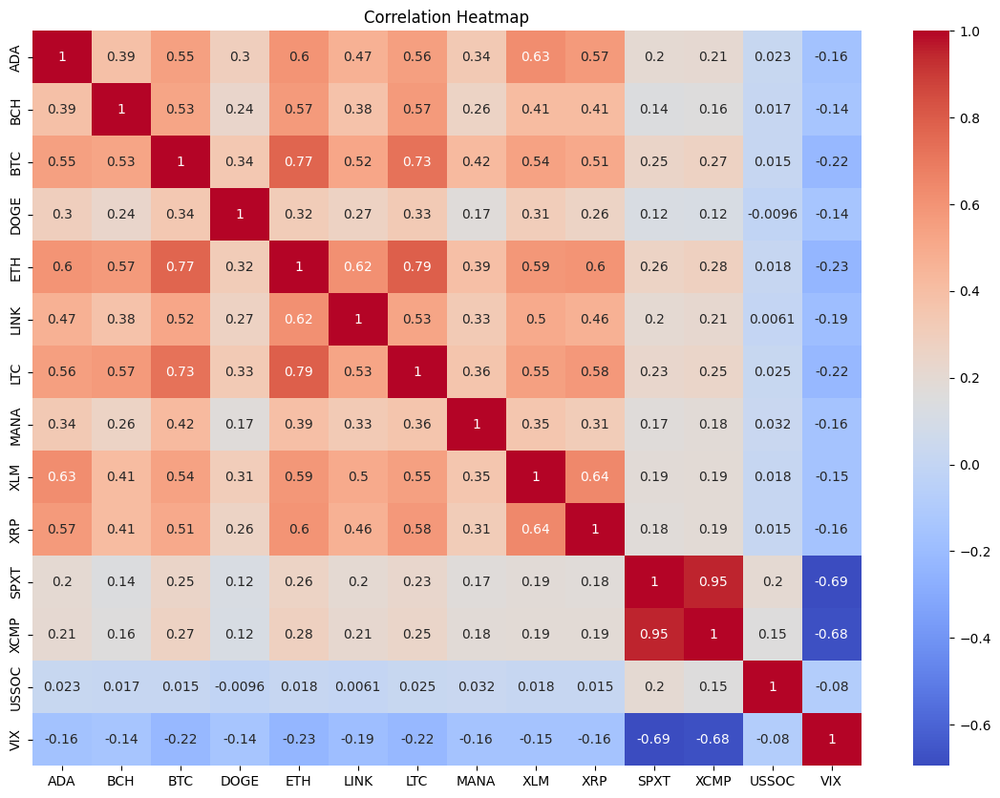

In [4]:
# Heatmap: correlation over the assets
plt.figure(figsize=(14, 10))
correlation_matrix = data.corr() 
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

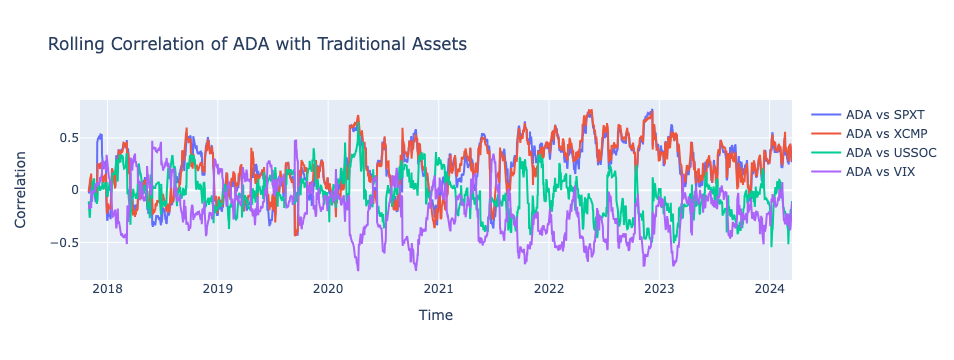

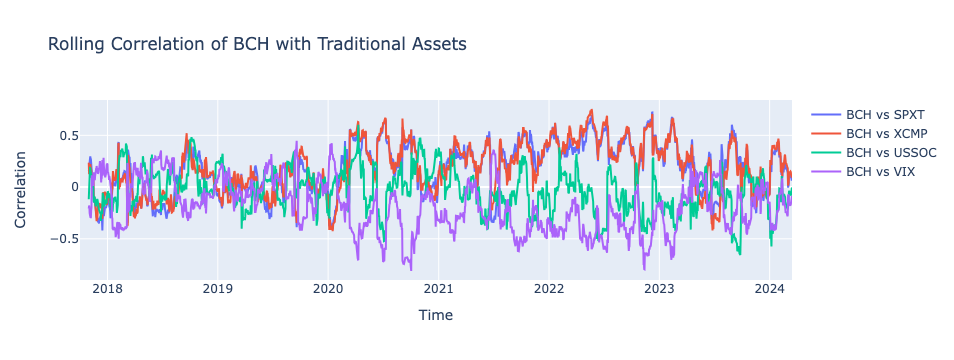

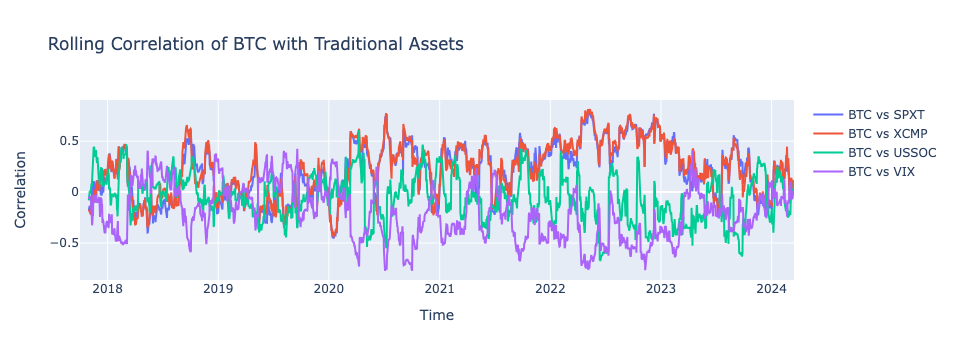

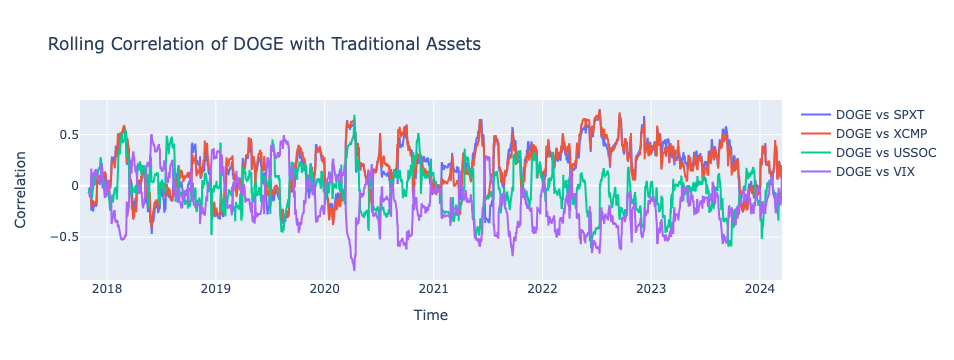

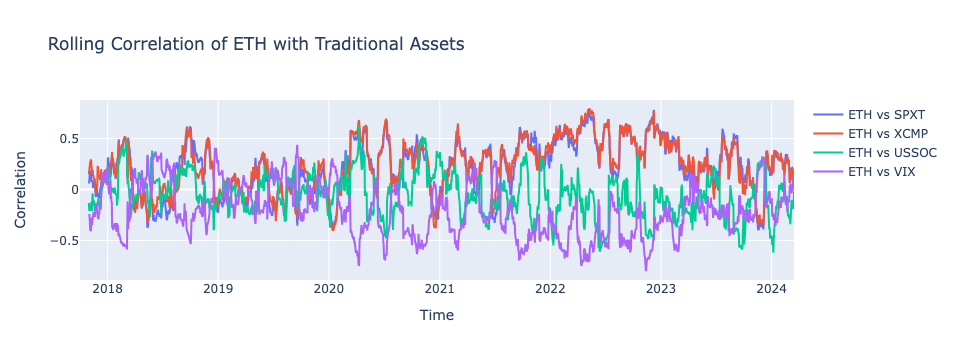

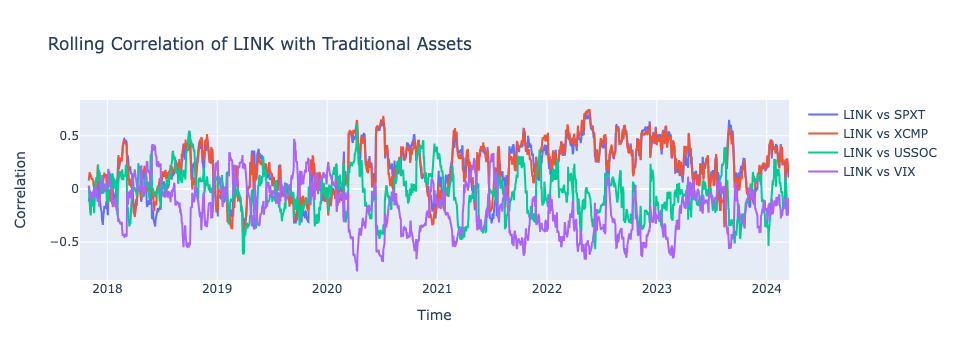

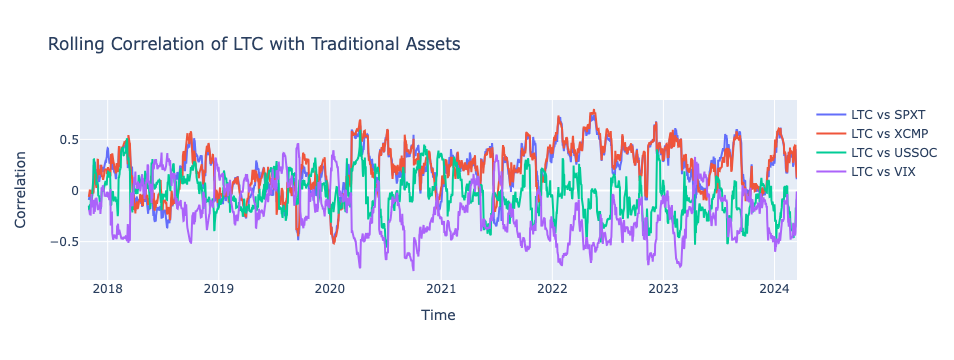

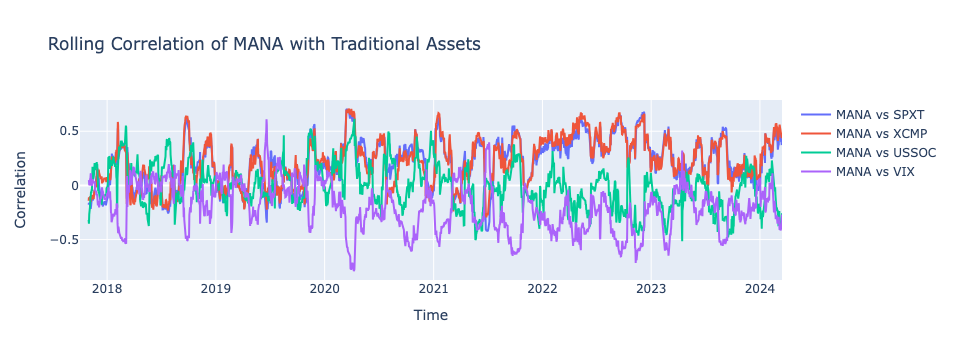

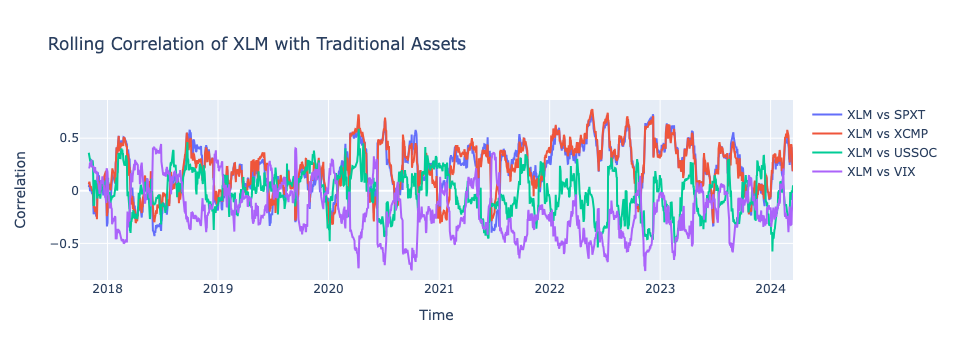

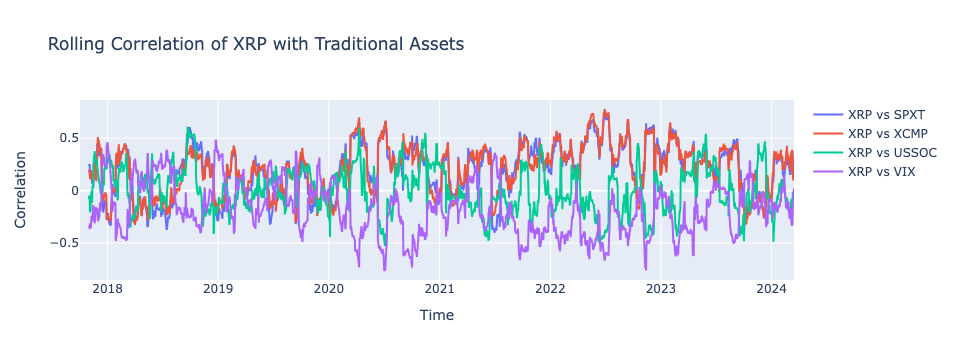

In [5]:
# Rolling correlations for crypto and traditional assets
window_size = 30  # 30 days rolling window

# Iterate over each cryptocurrency
for crypto in cryptos: # ['ADA', 'BCH', 'BTC', 'DOGE', 'ETH', 'LINK', 'LTC', 'MANA', 'XLM', 'XRP']
    
    fig = go.Figure()
    
    # Iterate over each traditional asset
    for trad in indices: # ['SPXT', 'XCMP', 'USSOC', 'VIX']
        # Calculate rolling correlation
        rolling_corr = data[crypto].rolling(window=window_size).corr(data[trad])
        
        # Ensure the index is a flat array for plotting
        rolling_corr_index = rolling_corr.index.values.flatten()
        fig.add_trace(go.Scatter(x = rolling_corr_index, y=rolling_corr.values, mode='lines', name=f'{crypto} vs {trad}'))
    
    fig.update_layout(title=f'Rolling Correlation of {crypto} with Traditional Assets',
                 xaxis_title='Time',
                 yaxis_title='Correlation')
    fig.show()

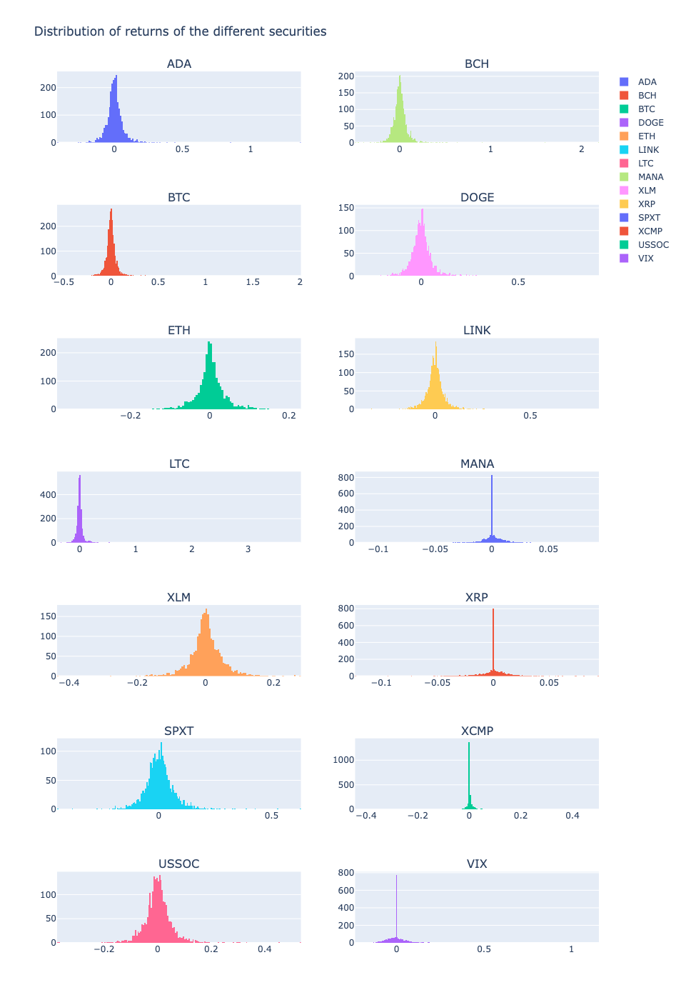

In [6]:
# Individual density of the assets

# Create generator to have the name of all securities
def give_col(data):
    for col in data.columns:
        yield col

def plot_sub_hist(df, show=True, rows_nb = 7, cols_nb = 2):
    column_generator = give_col(df)


    rows = rows_nb # Number of rows
    cols = cols_nb # Number of columns

    fig = make_subplots(rows=rows, cols=cols, subplot_titles=list(give_col(df)))
    # Loop through data and add traces
    for col in range(cols):
        col += 1
        for row in range(rows):
            row += 1
            sec = next(column_generator)
            trace = go.Histogram(
                x=df[sec], 
                nbinsx=300,
                name = f"{sec}")
            fig.append_trace(trace, row, col)

    fig.update_layout(
        height=rows*200, 
        width=1500, 
        title_text="Distribution of returns of the different securities")
    
    if show:
        fig.show()

plot_sub_hist(data)

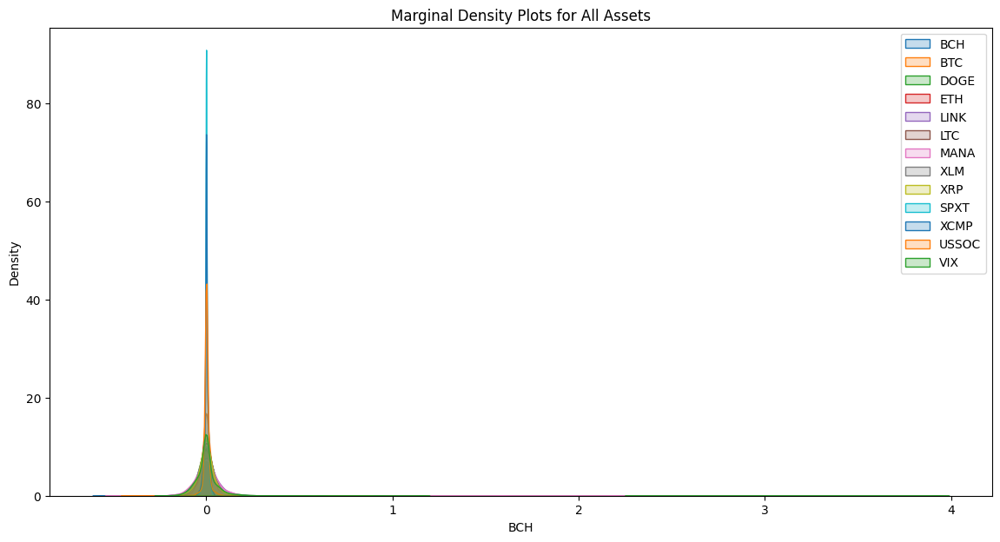

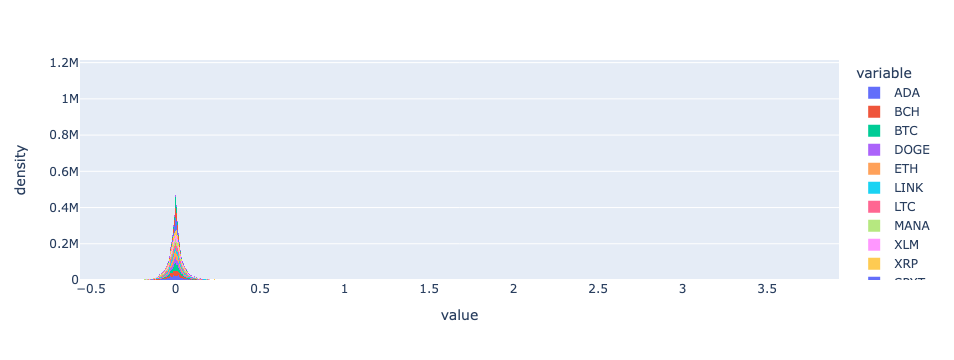

In [7]:
# Marginal density plots for each asset
plt.figure(figsize=(14, 7))
for column in data.columns[1:]:  # Skipping 'time' column
    sns.kdeplot(data[column].dropna(), fill=True, label=column)  # Drop NA values for kde plot
plt.title('Marginal Density Plots for All Assets')
plt.legend()
plt.show()

fig = px.histogram(
    data_frame=data, 
    histnorm='density')
fig.show()

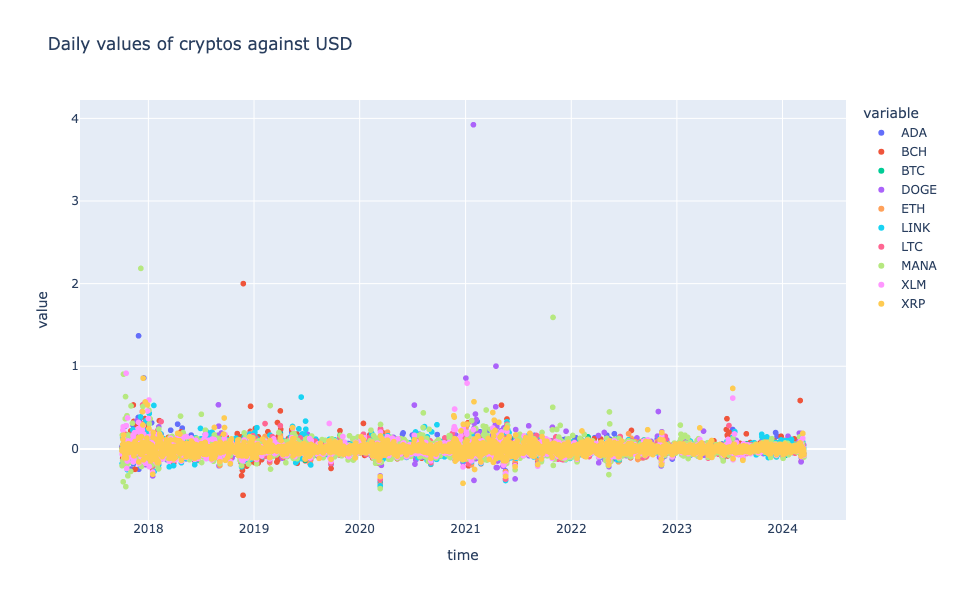

In [8]:
# Not sure that this is relevant - Could be removed ? # Agu: It is a little bit unreadable like this. Maybe we can separate the plots? 
fig = px.scatter(
    data,
    y = cryptos, x = data.index,
    color_continuous_scale='picnic',
    width = 1600, height = 600,
    title = 'Daily values of cryptos against USD',
)

fig.show()

### Question 1.a) Log returns

For this analysis, log returns should be used. The marginal distributions of crypto assets typically exhibit high kurtosis and skewness, suggesting a non-normal distribution. Log returns, which normalize and stabilize variance, are more suitable for the statistical models used in risk-based portfolio optimization, particularly when dealing with the high volatility of cryptocurrencies. Furthermore, cryptocurrency prices can fluctuate rapidly since they are traded continuously. Log returns, which consider compounding effects, provide a more accurate representation of returns. This choice aligns with Meucci's insights on the appropriateness of log returns for multiperiod investment horizons and assets with volatile behaviors.

In [9]:
# Tranform values into log
data_log = data.apply(lambda x: np.log(x+1))
disp(data)
disp(data.isna().sum(), 15)

,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
time,,,,,,,,,,,,,,
2017-10-02,0.027392,0.008261,-0.000402,-0.023234,-0.023491,-0.181214,-0.027555,-0.203082,-0.062725,-0.024964,0.00388,0.00320,0.00168,-0.00631
2017-10-03,-0.194745,-0.042087,-0.019799,-0.026641,-0.016846,-0.033296,-0.021392,0.166436,-0.045385,0.000985,0.00220,0.00238,0.00126,0.00635
2017-10-04,0.050384,-0.115200,-0.022141,-0.008798,-0.000445,0.134588,-0.017833,-0.144464,-0.048348,0.050172,0.00131,0.00060,0.00501,0.01262
2017-10-05,-0.016903,-0.004159,0.024363,-0.006903,0.011348,0.033163,0.008200,-0.063668,0.226926,0.114754,0.00582,0.00778,0.00624,-0.04569
2017-10-06,-0.140799,0.025370,0.011686,0.016882,0.045222,0.155556,0.008521,-0.398374,0.268461,-0.019328,-0.00076,0.00075,0.00413,0.05005


(2357, 14)


ADA      0
BCH      0
BTC      0
DOGE     0
ETH      0
LINK     0
LTC      0
MANA     0
XLM      0
XRP      0
SPXT     0
XCMP     0
USSOC    0
VIX      0
dtype: int64

(14,)


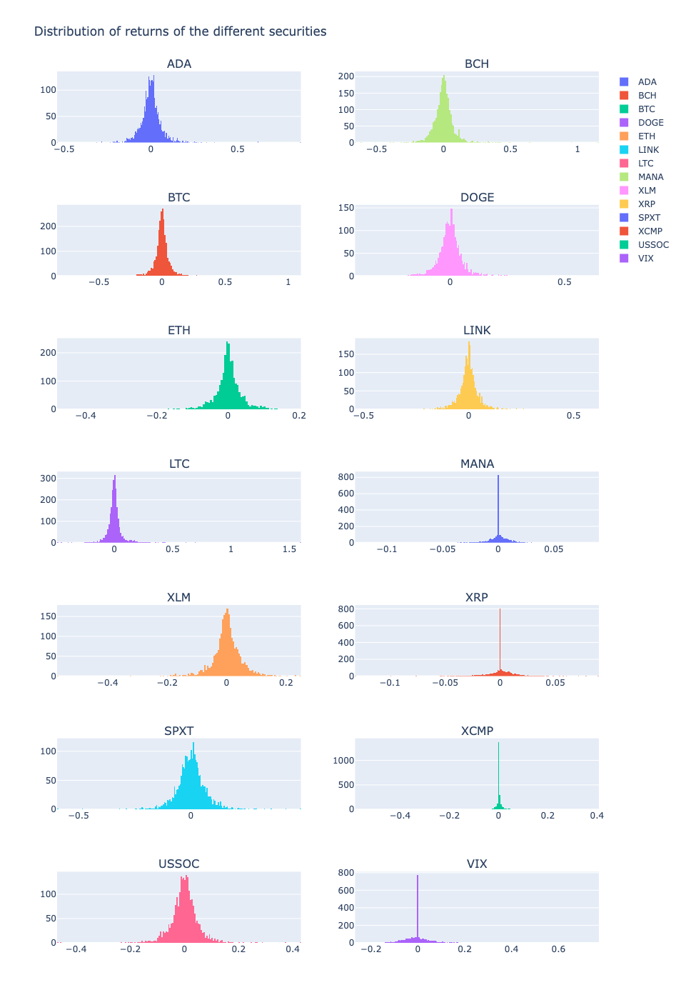

In [10]:
# Individual distribution of log returns
plot_sub_hist(data_log)

### Question 1.b) Outliers

#### Using linear returns - for information

In [11]:
# Identify potential outliers
potential_outliers = data[(np.abs(data - data.mean()) > (3 * data.std())).any(axis=1)]
disp(potential_outliers)

,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
time,,,,,,,,,,,,,,
2017-10-05,-0.016903,-0.004159,0.024363,-0.006903,0.011348,0.033163,0.008200,-0.063668,0.226926,0.114754,0.00582,0.00778,0.00624,-0.04569
2017-10-06,-0.140799,0.025370,0.011686,0.016882,0.045222,0.155556,0.008521,-0.398374,0.268461,-0.019328,-0.00076,0.00075,0.00413,0.05005
2017-10-07,0.124932,-0.008587,0.014609,0.017578,0.009503,-0.009615,0.009409,0.904177,0.130033,0.026992,0.00000,0.00000,0.00000,0.00000
2017-10-12,0.169552,-0.012066,0.126118,0.014479,0.000099,-0.016700,0.175822,0.097902,-0.082353,-0.063830,-0.00160,-0.00181,0.00082,0.00609
2017-10-13,0.272865,0.029487,0.037669,-0.029496,0.112054,-0.018342,-0.011219,0.364877,-0.004459,0.056006,0.00089,0.00217,-0.00082,-0.03027


(258, 14)


In [12]:
# Calculate the IQR for each column except 'time' and identify outliers
Q1 = data.quantile(0.25)
Q3 = data.quantile(0.75)
IQR = Q3 - Q1
outliers = (data < (Q1 - 3 * IQR)) | (data > (Q3 + 3 * IQR))

# Calculate the total number of outliers identified
total_outliers = outliers.sum().sum()  # Summing up all True values for outliers

# Handle outliers: Replace them with NaN for columns other than 'time'
data_cleaned = data.copy()
data_cleaned = data.mask(outliers)

# Fill NaN values using forward fill, then backward fill for any remaining at the start
data_cleaned.fillna(method='ffill', inplace=True)
data_cleaned.fillna(method='bfill', inplace=True)

# Print the total number of outliers
print("Total number of outliers identified:", total_outliers)


disp(outliers)

Total number of outliers identified: 1361


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
time,,,,,,,,,,,,,,
2017-10-02,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2017-10-03,True,False,False,False,False,False,False,False,False,False,False,False,False,False
2017-10-04,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2017-10-05,False,False,False,False,False,False,False,False,True,False,False,False,False,False
2017-10-06,False,False,False,False,False,False,False,True,True,False,False,False,False,False


(2357, 14)


We conducted outlier detection using two distinct statistical methods due to the unique characteristics of financial data, especially in highly volatile markets like those of cryptocurrencies.

Standard Deviation Method: The first approach involved identifying outliers as those data points lying beyond three standard deviations from the mean. While commonly used in many fields for outlier detection, this method proved overly sensitive for our dataset. It flagged a large number of data points as outliers, which upon further examination, were within plausible ranges for cryptocurrency returns. This high sensitivity is attributed to the large standard deviations characteristic of these markets, suggesting that the method might not be suitable for data with high volatility.

Interquartile Range (IQR) Method: Given the limitations observed with the standard deviation approach, we shifted to the IQR method. The IQR technique is less affected by extreme values and provides a more robust measure for identifying outliers in skewed distributions. Initially, a commonly used multiplier of 1.5 was applied to the IQR to define the outliers, which still resulted in a high number of outliers. Adjusting the multiplier to 3 significantly reduced the count to 1361 outliers, offering a more reasonable quantification (relatively to our original dataset size) that reflects true anomalous behaviors without discarding legitimate data variations.

Handling Identified Outliers: After identifying outliers with the adjusted IQR method, we handled these by initially replacing them with NaN values to prevent any distortion in the subsequent analysis. To maintain the continuity and integrity of our time series data, these NaN values were then addressed using forward filling (ffill), which propagates the last valid observation forward. Where forward filling was insufficient (e.g., at the start of the data series), backward filling (bfill) was employed to ensure no data point was left unfilled. This approach helps in preserving the temporal structure of the data while minimizing the impact of extreme value fluctuations.



#### Using log returns

In [13]:
# Calculate log returns for all assets
data_log_returns = np.log1p(data)

# Calculate the IQR for log returns
Q1_log = data_log_returns.quantile(0.25)
Q3_log = data_log_returns.quantile(0.75)
IQR_log = Q3_log - Q1_log

# Identify outliers using the IQR method for log returns
outliers_log = (data_log_returns < (Q1_log - 3 * IQR_log)) | (data_log_returns > (Q3_log + 3 * IQR_log))

# Calculate the total number of outliers
total_outliers_log = outliers_log.sum().sum()

# Handle outliers by replacing them with NaN and then forward-filling
data_log_returns_masked = data_log_returns.mask(outliers_log)
data_log_returns_filled = data_log_returns_masked.fillna(method='ffill').fillna(method='bfill')

print("Total number of outliers identified:", total_outliers_log)
disp(data_log_returns_filled)


Total number of outliers identified: 1335


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
time,,,,,,,,,,,,,,
2017-10-02,0.027023,0.008227,-0.000402,-0.023508,-0.023771,-0.199933,-0.027941,-0.227003,-0.064779,-0.025281,0.003872,0.003195,0.001679,-0.006330
2017-10-03,0.027023,-0.042999,-0.019997,-0.027003,-0.016989,-0.033863,-0.021625,0.153953,-0.046447,0.000984,0.002198,0.002377,0.001259,0.006330
2017-10-04,0.049156,-0.122394,-0.022390,-0.008837,-0.000446,0.126269,-0.017994,-0.156027,-0.049556,0.048954,0.001309,0.000600,0.004997,0.012541
2017-10-05,-0.017047,-0.004168,0.024071,-0.006927,0.011284,0.032625,0.008166,-0.065785,-0.049556,0.108634,0.005803,0.007750,0.006221,-0.046767
2017-10-06,-0.151753,0.025053,0.011618,0.016741,0.044229,0.144581,0.008484,-0.065785,-0.049556,-0.019517,-0.000760,0.000750,0.004121,0.048838


(2357, 14)


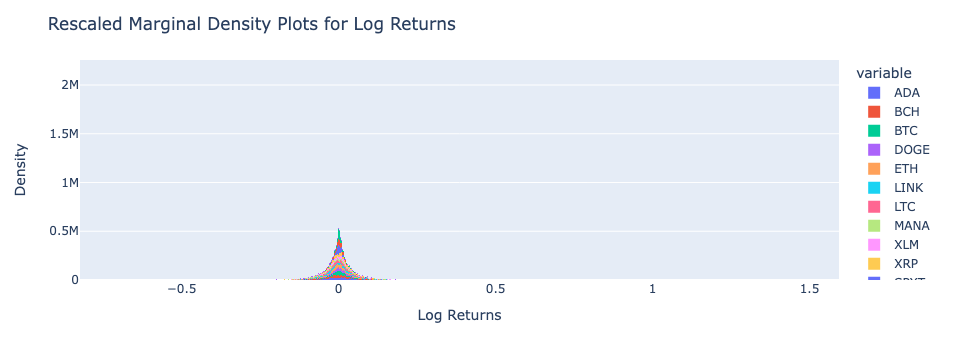

Skewness of Log Returns:
USSOC   -5.381134
SPXT    -0.938417
ETH     -0.913266
BTC     -0.874943
XCMP    -0.701816
LINK    -0.063058
LTC     -0.033353
BCH      1.034068
XRP      1.183144
XLM      1.424004
ADA      1.712513
VIX      1.819097
MANA     1.876837
DOGE     5.291092
dtype: float64

Kurtosis of Log Returns:
LINK       7.096355
LTC        9.881257
ETH       11.354044
XCMP      12.018778
BTC       13.122109
VIX       14.133608
XLM       15.967160
XRP       19.222877
SPXT      22.430946
ADA       24.094635
MANA      29.438379
BCH       40.428361
DOGE     107.715506
USSOC    120.437470
dtype: float64


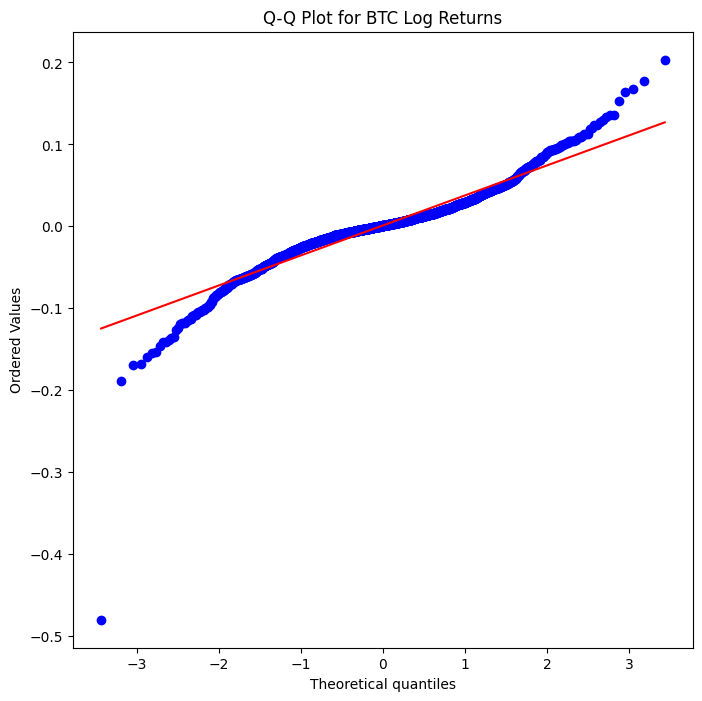

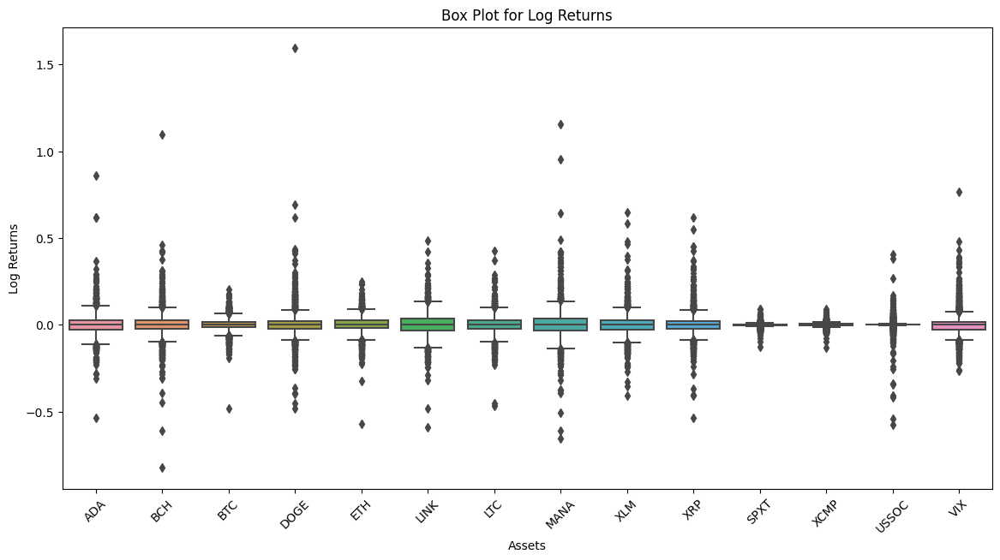

In [14]:
from scipy import stats

# First, let's rescale the marginal density plots with log returns
fig = px.histogram(
    data_frame=data_log_returns, 
    histnorm='density')
fig.update_layout(title=f'Rescaled Marginal Density Plots for Log Returns',
                 xaxis_title='Log Returns',
                 yaxis_title='Density')
fig.show()

# Same plot with different librairy
# plt.figure(figsize=(14, 7))
# for column in data_log_returns.columns:
#     sns.kdeplot(data_log_returns[column].dropna(), fill=True, label=column)
# plt.title('Rescaled Marginal Density Plots for Log Returns')
# plt.xlabel('Log Returns')
# plt.ylabel('Density')
# plt.legend()
# plt.show()

# Now, we'll conduct statistical tests for skewness and kurtosis to quantify the shape of the distribution.
skewness = data_log_returns.skew().sort_values()
kurtosis = data_log_returns.kurtosis().sort_values()

# Display skewness and kurtosis values
print("Skewness of Log Returns:")
print(skewness)
print("\nKurtosis of Log Returns:")
print(kurtosis)

# Next, we'll create a Q-Q plot for one of the assets to visually inspect its distribution against a normal distribution.
# Here we use BTC as an example. we would repeat this for other assets or iterate over all.
plt.figure(figsize=(8, 8))
stats.probplot(data_log_returns['BTC'].dropna(), dist="norm", plot=plt)
plt.title('Q-Q Plot for BTC Log Returns')
plt.show()

# Lastly, we'll plot a box plot to visualize the spread and outliers in the log returns.
plt.figure(figsize=(14, 7))
sns.boxplot(data=data_log_returns)
plt.title('Box Plot for Log Returns')
plt.xlabel('Assets')
plt.ylabel('Log Returns')
plt.xticks(rotation=45)
plt.show()


### Question 1.c) Total returns

Does it Matter in General?
Yes, significantly because of 2 aspects:

- Accuracy in Returns: Total return indices, which include dividends, provide a fuller picture of the true returns an investor would receive, as they reflect both price changes and income from dividends.
- Benchmarking and Relevance: They offer a more realistic benchmark for assessing investment performance and are particularly relevant for investors who reinvest dividends.

For the Risk-Based Portfolio Optimizations in This Study?
Indeed, it is also crucial:

- Impact on Risk and Reward: The inclusion of dividends affects both the risk and return calculations, altering the risk-return profile used in portfolio optimizations.
- Influence on Diversification: These indices might show different behaviors compared to price-only indices, particularly affecting diversification strategies due to changes in asset correlations.
- Optimization Outcomes: Total return indices can shift the efficient frontier upward, leading to different optimal portfolio compositions and weightings.

In a nutshell, using total return indices like SPXT and XCMP is essential for realistic and effective portfolio management, especially in a study focusing on risk-based optimization. This approach ensures that all components of returns are considered, facilitating more accurate decision-making in portfolio construction and management.

### Question 1.d) Weekend activity

Observation and Impact:
For traditional assets like SPXT and XCMP, zero returns over weekends are noted because these markets are closed, whereas cryptocurrencies trade 24/7, leading to non-zero returns every day. This discrepancy can distort correlation calculations between traditional and crypto assets, as weekends introduce artificial stability into the returns of traditional assets.

This is a problem for statistical analyses, especially when calculating correlations or conducting any comparative time series analysis. The zero returns can artificially lower the volatility and skew the correlation metrics between traditional and crypto assets.

Suggested Solution:

- Synchronize the Data: One approach is to adjust the dataset so that returns for traditional assets are only calculated on days when those markets are open (i.e., exclude weekends). Alternatively, calculate weekly returns instead of daily returns to ensure comparability across all assets.
- Use Imputation: For correlation purposes and other time-sensitive analyses, impute weekend returns for traditional assets using interpolation or forward-filling from the nearest non-zero data point. This maintains data continuity without introducing significant bias.
This methodological adjustment helps align the data temporally, providing more accurate and meaningful analytical outcomes, particularly in mixed-asset portfolios like those including both traditional and crypto assets.

## Part 2

### Question 2.a) Equally weigthed portfolio

In [15]:
disp(data_log_returns)
weights_EW = 1 / len(data_log_returns.columns)

,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
time,,,,,,,,,,,,,,
2017-10-02,0.027023,0.008227,-0.000402,-0.023508,-0.023771,-0.199933,-0.027941,-0.227003,-0.064779,-0.025281,0.003872,0.003195,0.001679,-0.006330
2017-10-03,-0.216596,-0.042999,-0.019997,-0.027003,-0.016989,-0.033863,-0.021625,0.153953,-0.046447,0.000984,0.002198,0.002377,0.001259,0.006330
2017-10-04,0.049156,-0.122394,-0.022390,-0.008837,-0.000446,0.126269,-0.017994,-0.156027,-0.049556,0.048954,0.001309,0.000600,0.004997,0.012541
2017-10-05,-0.017047,-0.004168,0.024071,-0.006927,0.011284,0.032625,0.008166,-0.065785,0.204512,0.108634,0.005803,0.007750,0.006221,-0.046767
2017-10-06,-0.151753,0.025053,0.011618,0.016741,0.044229,0.144581,0.008484,-0.508119,0.237804,-0.019517,-0.000760,0.000750,0.004121,0.048838


(2357, 14)


In [16]:
portfolio_EW = data_log_returns.copy()
portfolio_EW["Return_EW"] = portfolio_EW.apply(lambda row: row.sum(), axis=1) * weights_EW
disp(portfolio_EW)

,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX,Return_EW
time,,,,,,,,,,,,,,,
2017-10-02,0.027023,0.008227,-0.000402,-0.023508,-0.023771,-0.199933,-0.027941,-0.227003,-0.064779,-0.025281,0.003872,0.003195,0.001679,-0.006330,-0.039639
2017-10-03,-0.216596,-0.042999,-0.019997,-0.027003,-0.016989,-0.033863,-0.021625,0.153953,-0.046447,0.000984,0.002198,0.002377,0.001259,0.006330,-0.018458
2017-10-04,0.049156,-0.122394,-0.022390,-0.008837,-0.000446,0.126269,-0.017994,-0.156027,-0.049556,0.048954,0.001309,0.000600,0.004997,0.012541,-0.009558
2017-10-05,-0.017047,-0.004168,0.024071,-0.006927,0.011284,0.032625,0.008166,-0.065785,0.204512,0.108634,0.005803,0.007750,0.006221,-0.046767,0.019169
2017-10-06,-0.151753,0.025053,0.011618,0.016741,0.044229,0.144581,0.008484,-0.508119,0.237804,-0.019517,-0.000760,0.000750,0.004121,0.048838,-0.009852


(2357, 15)


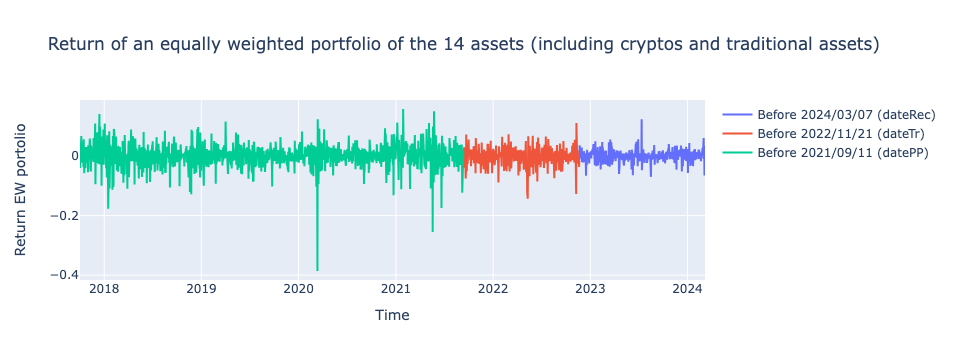

In [17]:
# Plot the returns of the portfolio EW
fig = go.Figure()

fig.add_trace(go.Scatter(x = portfolio_EW.loc[dateTr:dateRec].index, 
                 y=portfolio_EW.loc[dateTr:dateRec].Return_EW, 
                 mode='lines', 
                 name=f'Before {datetime.strftime(dateRec,"%Y/%m/%d")} (dateRec)',
                 ))

fig.add_trace(go.Scatter(x = portfolio_EW.loc[datePP:dateTr].index, 
                 y=portfolio_EW.loc[datePP:dateTr].Return_EW, 
                 mode='lines', 
                 name=f'Before {datetime.strftime(dateTr,"%Y/%m/%d")} (dateTr)',
                 ))

fig.add_trace(go.Scatter(x = portfolio_EW.loc[:datePP].index, 
                 y=portfolio_EW.loc[:datePP].Return_EW, 
                 mode='lines', 
                 name=f'Before {datetime.strftime(datePP,"%Y/%m/%d")} (datePP)',
                 ))

fig.update_layout(title=f'Return of an equally weighted portfolio of the 14 assets (including cryptos and traditional assets)',
                xaxis_title='Time',
                yaxis_title='Return EW portolio')

fig.show()

### Question 2.b) Covariance matrix

#### Using information from Lopez de Prado 2016.

In [18]:
# Prado 2016: need 0.5*N*(N-1)IID observations to get non singular variance covariance matrix of size N. Here: N=14
N = len(data.columns)
size = 0.5*N*(N-1)
print(f"Use {size} days of data")

Use 91.0 days of data


In [19]:
print(f"Variance covariance matrix - on {datetime.strftime(dateTr, '%Y/%m/%d')} (dateTr)")
cov_matrix_datePP = data_log_returns.loc[dateTr-timedelta(size):dateTr].cov()
display(cov_matrix_datePP)

print(f"Variance covariance matrix - on {datetime.strftime(datePP, '%Y/%m/%d')} (datePP)")
cov_matrix_dateTr = data_log_returns.loc[datePP-timedelta(size):datePP].cov()
display(cov_matrix_dateTr)

Variance covariance matrix - on 2022/11/21 (dateTr)


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
ADA,0.001662,0.001445,0.001140,0.001781,0.001660,0.001793,0.001371,0.001629,0.001307,0.001608,0.000292,0.000361,-0.000070,-0.000713
BCH,0.001445,0.001882,0.001197,0.001827,0.001739,0.001876,0.001535,0.001583,0.001380,0.001733,0.000251,0.000312,-0.000060,-0.000754
BTC,0.001140,0.001197,0.001125,0.001452,0.001407,0.001399,0.001158,0.001325,0.001105,0.001355,0.000262,0.000316,-0.000055,-0.000660
DOGE,0.001781,0.001827,0.001452,0.004461,0.002217,0.002142,0.001647,0.002018,0.001530,0.001934,0.000313,0.000367,-0.000067,-0.000869
ETH,0.001660,0.001739,0.001407,0.002217,0.002232,0.002029,0.001694,0.001863,0.001486,0.001873,0.000327,0.000398,-0.000058,-0.000916
LINK,0.001793,0.001876,0.001399,0.002142,0.002029,0.002779,0.001721,0.002049,0.001609,0.002052,0.000316,0.000380,-0.000074,-0.000860
LTC,0.001371,0.001535,0.001158,0.001647,0.001694,0.001721,0.001995,0.001522,0.001299,0.001606,0.000217,0.000270,-0.000061,-0.000716
MANA,0.001629,0.001583,0.001325,0.002018,0.001863,0.002049,0.001522,0.001984,0.001521,0.001916,0.000287,0.000347,-0.000057,-0.000788
XLM,0.001307,0.001380,0.001105,0.001530,0.001486,0.001609,0.001299,0.001521,0.001661,0.001977,0.000203,0.000254,-0.000040,-0.000589
XRP,0.001608,0.001733,0.001355,0.001934,0.001873,0.002052,0.001606,0.001916,0.001977,0.002898,0.000222,0.000261,-0.000019,-0.000609


Variance covariance matrix - on 2021/09/11 (datePP)


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
ADA,0.003095,0.001903,0.001470,0.003022,0.001929,0.002568,0.002182,0.002543,0.002418,0.002788,0.000040,0.000049,-0.000235,-0.000725
BCH,0.001903,0.002103,0.001482,0.002787,0.001874,0.002538,0.002238,0.002446,0.002319,0.002560,0.000029,0.000047,-0.000097,-0.000632
BTC,0.001470,0.001482,0.001461,0.002152,0.001533,0.001994,0.001681,0.001856,0.001642,0.001772,0.000023,0.000034,-0.000062,-0.000535
DOGE,0.003022,0.002787,0.002152,0.005929,0.002840,0.003497,0.003147,0.003723,0.003384,0.003739,0.000008,0.000051,-0.000157,-0.000635
ETH,0.001929,0.001874,0.001533,0.002840,0.002345,0.002560,0.002135,0.002517,0.002169,0.002304,0.000033,0.000062,-0.000156,-0.000740
LINK,0.002568,0.002538,0.001994,0.003497,0.002560,0.003845,0.002788,0.003143,0.002940,0.003083,0.000033,0.000051,-0.000057,-0.000721
LTC,0.002182,0.002238,0.001681,0.003147,0.002135,0.002788,0.002783,0.002746,0.002481,0.002756,0.000020,0.000045,-0.000092,-0.000620
MANA,0.002543,0.002446,0.001856,0.003723,0.002517,0.003143,0.002746,0.004952,0.002855,0.002993,0.000049,0.000055,0.000034,-0.000986
XLM,0.002418,0.002319,0.001642,0.003384,0.002169,0.002940,0.002481,0.002855,0.003239,0.003252,0.000039,0.000054,-0.000158,-0.000949
XRP,0.002788,0.002560,0.001772,0.003739,0.002304,0.003083,0.002756,0.002993,0.003252,0.004198,0.000009,0.000033,-0.000153,-0.000647


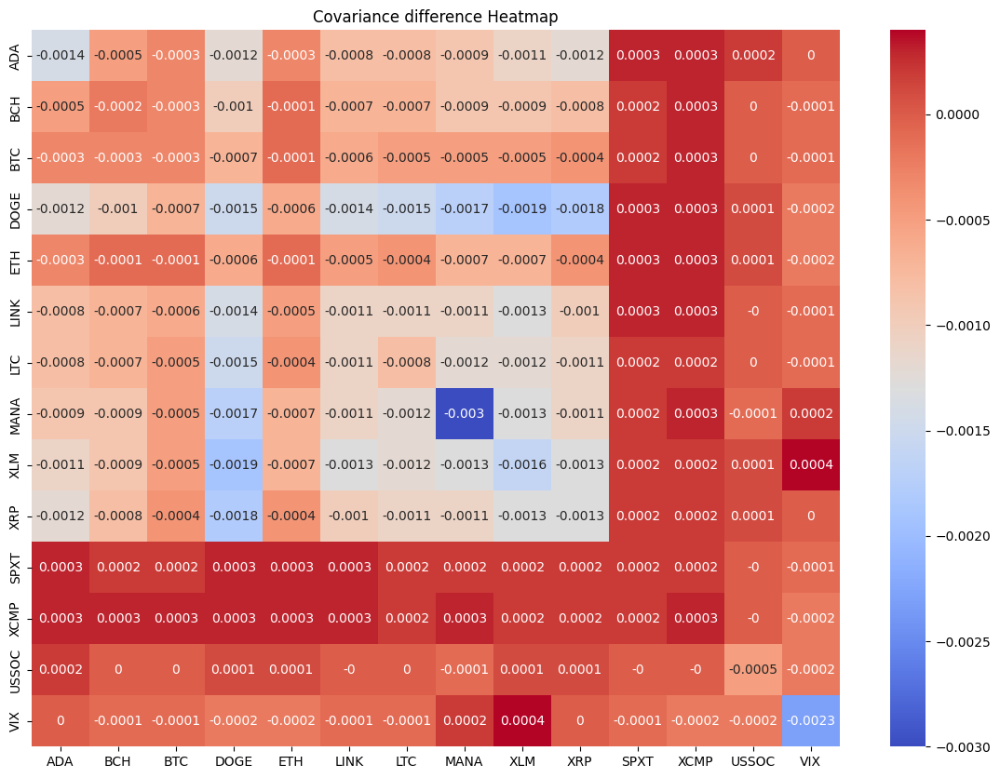

In [20]:
# Test: might be totally wrong to do that: plot a heat map of the difference of covariance between the two dates
diff_covariance = round(cov_matrix_datePP - cov_matrix_dateTr, 4)

# Before datePP
plt.figure(figsize=(14, 10))
sns.heatmap(diff_covariance, annot=True, cmap='coolwarm')
plt.title('Covariance difference Heatmap')
plt.show()

#### Quick version - need further research

In [21]:
cov_matrix_datePP_ = data_log_returns[data_log_returns.index < datePP].cov()
display(cov_matrix_datePP_)

cov_matrix_dateTr_ = data_log_returns.loc[datePP:dateTr].cov()
display(cov_matrix_dateTr_)

,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
ADA,0.005712,0.002953,0.001904,0.002559,0.002715,0.002907,0.002746,0.002964,0.003669,0.003181,0.000148,0.000165,0.000183,-0.000791
BCH,0.002953,0.006821,0.002120,0.002408,0.002944,0.002744,0.003136,0.002690,0.002917,0.002816,0.000126,0.000151,0.000169,-0.000821
BTC,0.001904,0.002120,0.001842,0.001593,0.001798,0.001720,0.001918,0.001890,0.001756,0.001588,0.000097,0.000115,0.000114,-0.000583
DOGE,0.002559,0.002408,0.001593,0.007263,0.001906,0.002310,0.002222,0.002085,0.002459,0.002162,0.000125,0.000134,0.000076,-0.000992
ETH,0.002715,0.002944,0.001798,0.001906,0.002961,0.002623,0.002655,0.002389,0.002466,0.002413,0.000133,0.000156,0.000159,-0.000797
LINK,0.002907,0.002744,0.001720,0.002310,0.002623,0.006013,0.002465,0.002814,0.002950,0.002617,0.000147,0.000173,0.000124,-0.000904
LTC,0.002746,0.003136,0.001918,0.002222,0.002655,0.002465,0.003527,0.002399,0.002532,0.002562,0.000128,0.000148,0.000150,-0.000843
MANA,0.002964,0.002690,0.001890,0.002085,0.002389,0.002814,0.002399,0.008920,0.002798,0.002494,0.000186,0.000205,0.000296,-0.001124
XLM,0.003669,0.002917,0.001756,0.002459,0.002466,0.002950,0.002532,0.002798,0.005209,0.003288,0.000131,0.000146,0.000123,-0.000746
XRP,0.003181,0.002816,0.001588,0.002162,0.002413,0.002617,0.002562,0.002494,0.003288,0.004800,0.000112,0.000131,0.000115,-0.000692


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
ADA,0.002444,0.001729,0.001327,0.001821,0.001760,0.002124,0.001869,0.002180,0.001746,0.001720,0.000267,0.000375,-0.000027,-0.001284
BCH,0.001729,0.002103,0.001328,0.001699,0.001712,0.001926,0.001853,0.001907,0.001611,0.001589,0.000232,0.000325,-0.000055,-0.001129
BTC,0.001327,0.001328,0.001247,0.001340,0.001440,0.001479,0.001370,0.001454,0.001231,0.001228,0.000200,0.000278,-0.000068,-0.000926
DOGE,0.001821,0.001699,0.001340,0.003032,0.001787,0.001911,0.001782,0.001848,0.001586,0.001678,0.000238,0.000325,-0.000070,-0.001072
ETH,0.001760,0.001712,0.001440,0.001787,0.002136,0.002041,0.001805,0.001987,0.001595,0.001633,0.000257,0.000357,-0.000112,-0.001248
LINK,0.002124,0.001926,0.001479,0.001911,0.002041,0.003088,0.002034,0.002378,0.001894,0.001907,0.000269,0.000373,-0.000040,-0.001316
LTC,0.001869,0.001853,0.001370,0.001782,0.001805,0.002034,0.002245,0.001860,0.001669,0.001690,0.000229,0.000323,-0.000053,-0.001248
MANA,0.002180,0.001907,0.001454,0.001848,0.001987,0.002378,0.001860,0.006777,0.001943,0.001994,0.000303,0.000438,-0.000085,-0.001431
XLM,0.001746,0.001611,0.001231,0.001586,0.001595,0.001894,0.001669,0.001943,0.001907,0.001699,0.000202,0.000289,-0.000036,-0.001001
XRP,0.001720,0.001589,0.001228,0.001678,0.001633,0.001907,0.001690,0.001994,0.001699,0.002104,0.000208,0.000284,-0.000062,-0.001064


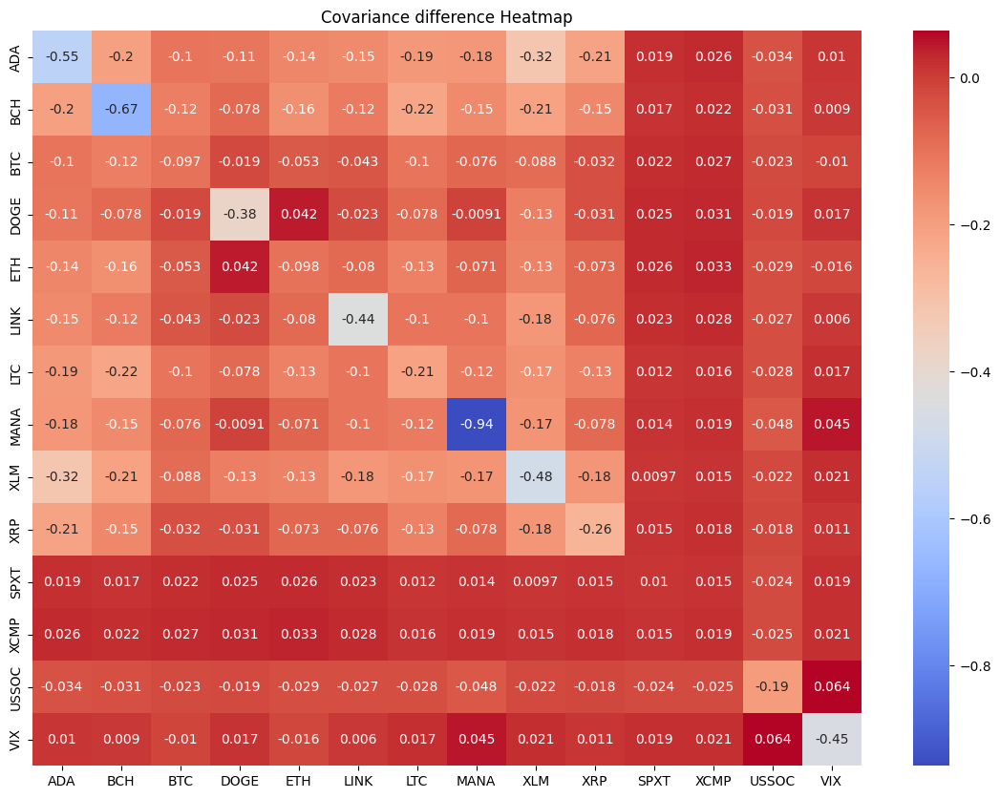

In [22]:
# Test of difference between variance covariance matrix with window / without
diff_datePP = (cov_matrix_datePP - cov_matrix_datePP_)

plt.figure(figsize=(14, 10))
sns.heatmap(diff_datePP/(np.max(diff_datePP)-np.min(diff_datePP)), annot=True, cmap='coolwarm')
plt.title('Covariance difference Heatmap')
plt.show()

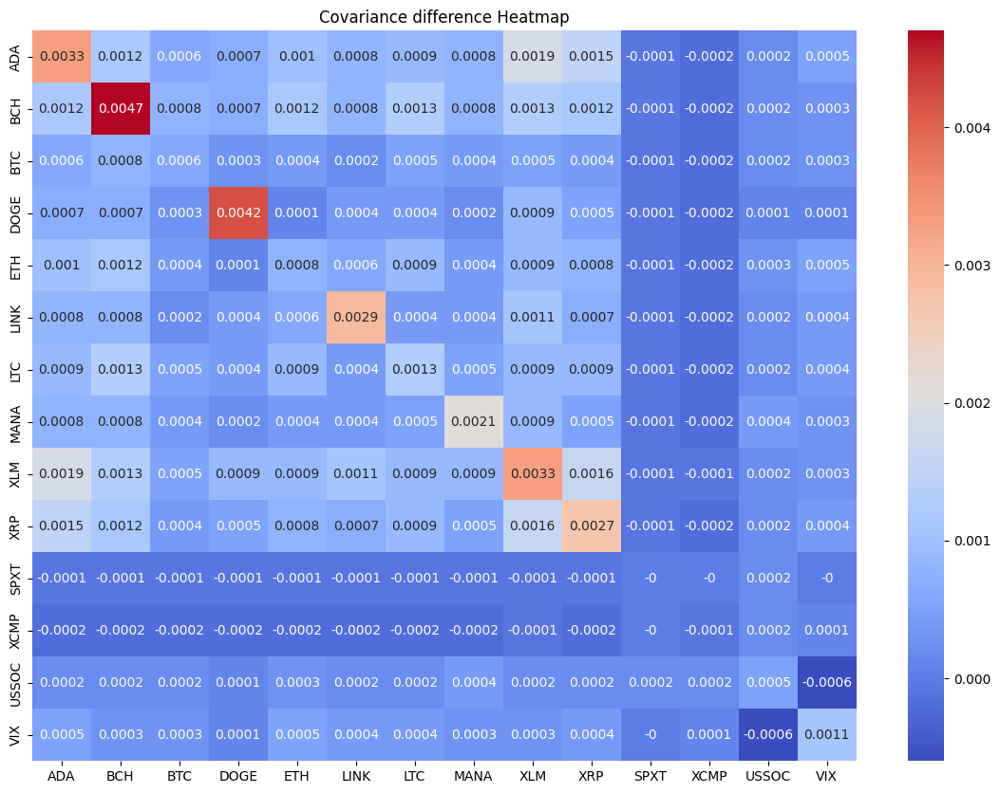

In [23]:
# Test: might be totally wrong to do that: plot a heat map of the difference of covariance between the two dates
diff_covariance_ = round(cov_matrix_datePP_ - cov_matrix_dateTr_, 4) #Agu: they seem to be pretty much the same

# Before datePP
plt.figure(figsize=(14, 10))
sns.heatmap(diff_covariance_, annot=True, cmap='coolwarm')
plt.title('Covariance difference Heatmap')
plt.show()

### Question 2.c) Clean the covariance matrix

In [24]:
# Clean the covariance matrix using the eigenvalues clipping method

def clean_covariance_matrix(cov_matrix, threshold=1e-10):

    # Spectral decomposition to obtain eigenvalues and eigenvectors
    eigenvalues, eigenvectors = np.linalg.eigh(cov_matrix)

    # Clip the eigenvalues
    clipped_eigenvalues = np.maximum(eigenvalues, threshold)

    # Reconstruct the covariance matrix 
    cleaned_covariance_matrix= np.dot(eigenvectors.T, np.dot(np.diag(clipped_eigenvalues), eigenvectors))
    
    return cleaned_covariance_matrix

#To delete 
#cleaned_covariance_matrix_datePP = clean_covariance_matrix_PP(cov_matrix_datePP)
#print("Cleaned Covariance Matrix (datePP):"
#print(cleaned_covariance_matrix_datePP)

cleaned_covariance_matrix_datePP = clean_covariance_matrix(cov_matrix_datePP)

cleaned_covariance_matrix_datePP_df = pd.DataFrame(cleaned_covariance_matrix_datePP, index=cov_matrix_datePP.index, columns=cov_matrix_datePP.columns)
display(cleaned_covariance_matrix_datePP_df)
diff_covVSclean = round(np.abs(cleaned_covariance_matrix_datePP_df - cov_matrix_datePP),5)
display(diff_covVSclean)

#To delete 
cleaned_covariance_matrix_dateTr = clean_covariance_matrix(cov_matrix_dateTr)

cleaned_covariance_matrix_dateTr_df = pd.DataFrame(cleaned_covariance_matrix_dateTr, index=cov_matrix_dateTr.index, columns=cov_matrix_dateTr.columns)
display(cleaned_covariance_matrix_dateTr_df)


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
ADA,1.235903e-03,6.499157e-05,-0.000147,-0.000018,0.000124,-0.000093,0.000069,-8.456282e-07,0.000012,-0.000019,0.000196,0.000512,1.446680e-05,-0.000102
BCH,6.499157e-05,2.105200e-03,-0.000142,0.000022,-0.000015,0.000147,-0.000187,-1.687942e-06,0.000061,0.000017,0.000089,0.000060,2.167997e-07,0.000009
BTC,-1.471833e-04,-1.416576e-04,0.000648,0.000015,-0.000492,0.000720,-0.000230,-1.388965e-04,0.000701,0.000135,0.000678,0.001479,1.298879e-05,-0.000205
DOGE,-1.767787e-05,2.223861e-05,0.000015,0.000340,0.000045,0.000143,-0.000068,-6.746934e-05,0.000058,-0.000016,0.000099,0.000171,8.550313e-06,-0.000046
ETH,1.240528e-04,-1.517789e-05,-0.000492,0.000045,0.000993,-0.000825,0.000169,2.243663e-04,-0.000677,-0.000110,-0.000709,-0.001825,6.502249e-06,0.000285
LINK,-9.308514e-05,1.466535e-04,0.000720,0.000143,-0.000825,0.001328,-0.000422,-2.994123e-04,0.001122,0.000193,0.001328,0.002941,4.749410e-05,-0.000502
LTC,6.924035e-05,-1.874119e-04,-0.000230,-0.000068,0.000169,-0.000422,0.000265,5.680503e-05,-0.000252,-0.000030,-0.000278,-0.000588,-2.384322e-05,0.000145
MANA,-8.456282e-07,-1.687942e-06,-0.000139,-0.000067,0.000224,-0.000299,0.000057,2.070509e-04,-0.000353,-0.000074,-0.000413,-0.001010,-4.344484e-05,0.000239
XLM,1.226978e-05,6.116239e-05,0.000701,0.000058,-0.000677,0.001122,-0.000252,-3.531729e-04,0.001310,0.000165,0.001535,0.003472,8.359143e-05,-0.000643
XRP,-1.854657e-05,1.735354e-05,0.000135,-0.000016,-0.000110,0.000193,-0.000030,-7.443691e-05,0.000165,0.000262,0.000176,0.000389,1.822938e-05,-0.000078


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
ADA,0.00043,0.00138,0.00129,0.00180,0.00154,0.00189,0.00130,0.00163,0.00129,0.00163,0.00010,0.00015,0.00008,0.00061
BCH,0.00138,0.00022,0.00134,0.00180,0.00175,0.00173,0.00172,0.00158,0.00132,0.00172,0.00016,0.00025,0.00006,0.00076
BTC,0.00129,0.00134,0.00048,0.00144,0.00190,0.00068,0.00139,0.00146,0.00040,0.00122,0.00042,0.00116,0.00007,0.00046
DOGE,0.00180,0.00180,0.00144,0.00412,0.00217,0.00200,0.00172,0.00209,0.00147,0.00195,0.00021,0.00020,0.00008,0.00082
ETH,0.00154,0.00175,0.00190,0.00217,0.00124,0.00285,0.00153,0.00164,0.00216,0.00198,0.00104,0.00222,0.00006,0.00120
LINK,0.00189,0.00173,0.00068,0.00200,0.00285,0.00145,0.00214,0.00235,0.00049,0.00186,0.00101,0.00256,0.00012,0.00036
LTC,0.00130,0.00172,0.00139,0.00172,0.00153,0.00214,0.00173,0.00146,0.00155,0.00164,0.00049,0.00086,0.00004,0.00086
MANA,0.00163,0.00158,0.00146,0.00209,0.00164,0.00235,0.00146,0.00178,0.00187,0.00199,0.00070,0.00136,0.00001,0.00103
XLM,0.00129,0.00132,0.00040,0.00147,0.00216,0.00049,0.00155,0.00187,0.00035,0.00181,0.00133,0.00322,0.00012,0.00005
XRP,0.00163,0.00172,0.00122,0.00195,0.00198,0.00186,0.00164,0.00199,0.00181,0.00264,0.00005,0.00013,0.00004,0.00053


,ADA,BCH,BTC,DOGE,ETH,LINK,LTC,MANA,XLM,XRP,SPXT,XCMP,USSOC,VIX
ADA,0.001639,-0.000024,-0.000036,-0.000051,0.000032,3.379116e-05,-0.000055,-0.000055,0.000048,0.000030,-0.000120,7.404754e-05,0.000946,0.000094
BCH,-0.000024,0.001995,-0.000164,-0.000053,0.000114,4.936543e-05,-0.000132,-0.000232,0.000128,0.000040,-0.000253,1.426635e-04,0.002194,0.000204
BTC,-0.000036,-0.000164,0.000155,0.000055,-0.000107,1.151683e-04,0.000014,-0.000189,-0.000055,0.000024,-0.000018,-1.403550e-04,-0.000489,-0.000211
DOGE,-0.000051,-0.000053,0.000055,0.000307,-0.000239,-1.156771e-04,0.000198,0.000024,0.000002,-0.000072,0.000116,-9.429337e-05,-0.001138,-0.000139
ETH,0.000032,0.000114,-0.000107,-0.000239,0.001046,-4.168544e-05,0.000135,0.000888,-0.000234,-0.000126,-0.000171,3.142143e-04,0.001315,0.000142
LINK,0.000034,0.000049,0.000115,-0.000116,-0.000042,7.727275e-04,-0.000406,-0.000763,0.000308,-0.000106,0.000010,-9.057477e-07,0.000386,0.000083
LTC,-0.000055,-0.000132,0.000014,0.000198,0.000135,-4.057778e-04,0.000919,0.000931,-0.000295,-0.000074,0.000152,7.301064e-05,-0.001303,-0.000059
MANA,-0.000055,-0.000232,-0.000189,0.000024,0.000888,-7.632169e-04,0.000931,0.002885,-0.000793,-0.000207,0.000125,3.297109e-04,-0.001746,-0.000123
XLM,0.000048,0.000128,-0.000055,0.000002,-0.000234,3.076749e-04,-0.000295,-0.000793,0.000535,-0.000229,0.000007,1.680509e-04,0.001049,0.000341
XRP,0.000030,0.000040,0.000024,-0.000072,-0.000126,-1.058153e-04,-0.000074,-0.000207,-0.000229,0.000499,-0.000125,-4.635592e-05,0.000562,-0.000110


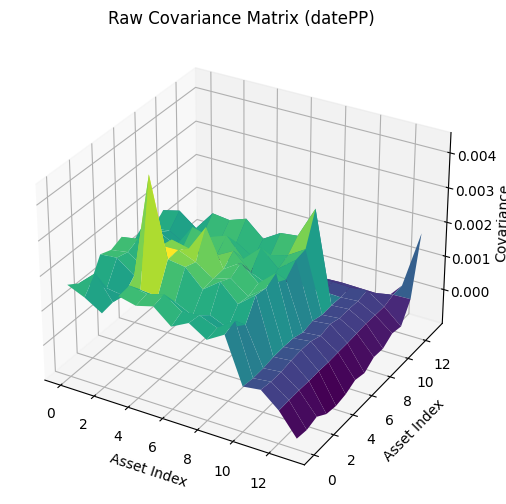

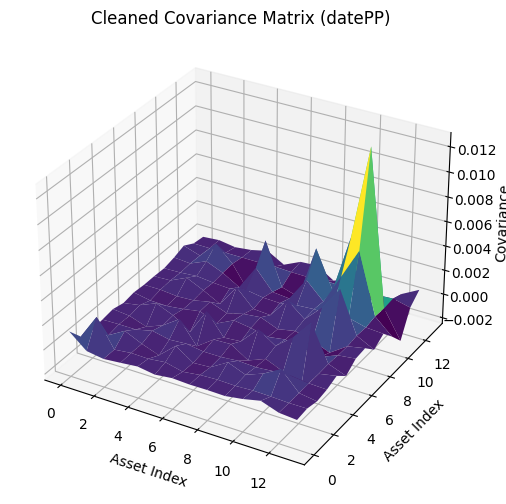

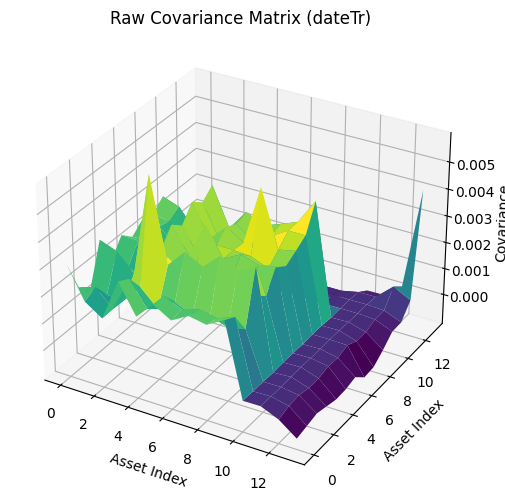

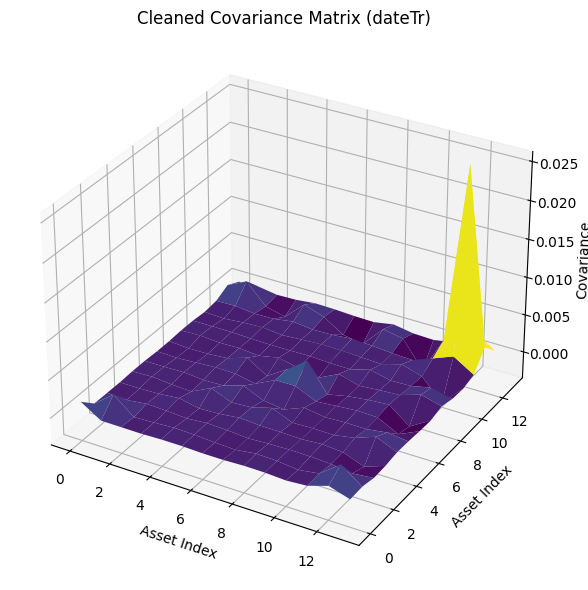

In [25]:
# Plot 3D visualizations of raw and cleaned covariance matrices at datePP

fig1 = plt.figure(figsize=(8, 6))
ax1 = fig1.add_subplot(111, projection='3d')
X1, Y1 = np.meshgrid(np.arange(len(cov_matrix_datePP)), np.arange(len(cov_matrix_datePP)))
ax1.plot_surface(X1, Y1, cov_matrix_datePP, cmap='viridis')
ax1.set_title('Raw Covariance Matrix (datePP)')
ax1.set_xlabel('Asset Index')
ax1.set_ylabel('Asset Index')
ax1.set_zlabel('Covariance')

fig2 = plt.figure(figsize=(8, 6))
ax2 = fig2.add_subplot(111, projection='3d')
X2, Y2 = np.meshgrid(np.arange(len(cleaned_covariance_matrix_datePP)), np.arange(len(cleaned_covariance_matrix_datePP)))
ax2.plot_surface(X2, Y2, cleaned_covariance_matrix_datePP, cmap='viridis')
ax2.set_title('Cleaned Covariance Matrix (datePP)')
ax2.set_xlabel('Asset Index')
ax2.set_ylabel('Asset Index')
ax2.set_zlabel('Covariance')

# Plot 3D visualizations of raw and cleaned covariance matrices at dateTr
fig3 = plt.figure(figsize=(8, 6))
ax3 = fig3.add_subplot(111, projection='3d')
X3, Y3 = np.meshgrid(np.arange(len(cov_matrix_dateTr)), np.arange(len(cov_matrix_dateTr)))
ax3.plot_surface(X3, Y3, cov_matrix_dateTr, cmap='viridis')
ax3.set_title('Raw Covariance Matrix (dateTr)')
ax3.set_xlabel('Asset Index')
ax3.set_ylabel('Asset Index')
ax3.set_zlabel('Covariance')

fig4 = plt.figure(figsize=(8, 6))
ax4 = fig4.add_subplot(111, projection='3d')
X4, Y4 = np.meshgrid(np.arange(len(cleaned_covariance_matrix_dateTr)), np.arange(len(cleaned_covariance_matrix_dateTr)))
ax4.plot_surface(X4, Y4, cleaned_covariance_matrix_dateTr, cmap='viridis')
ax4.set_title('Cleaned Covariance Matrix (dateTr)')
ax4.set_xlabel('Asset Index')
ax4.set_ylabel('Asset Index')
ax4.set_zlabel('Covariance')

plt.tight_layout()
plt.show()



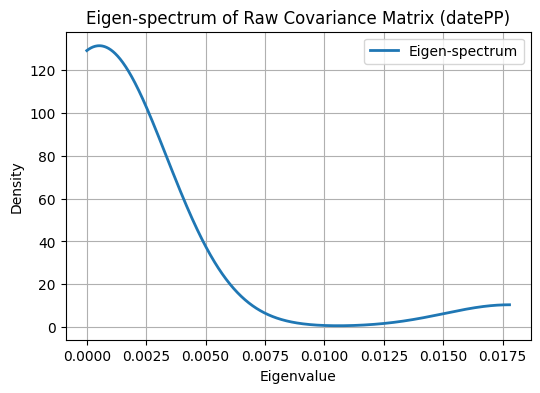

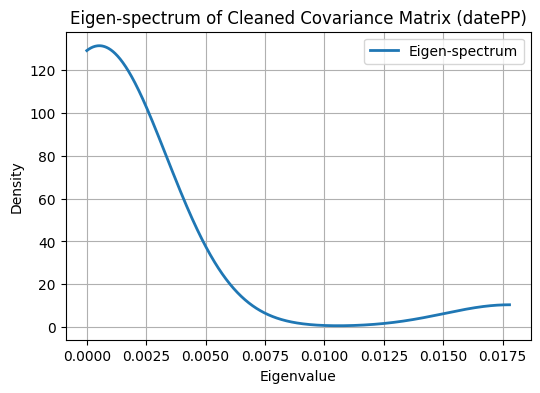

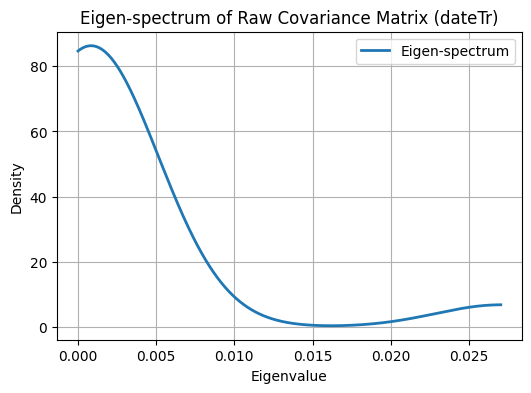

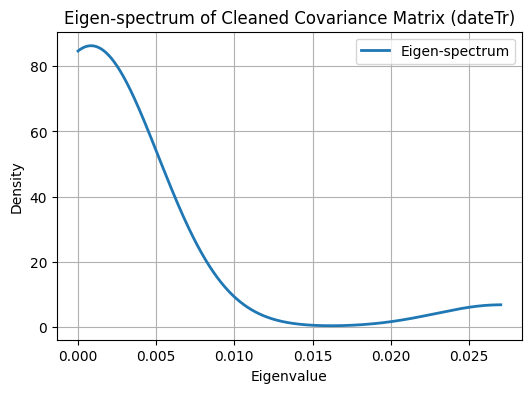

Condition number of Raw Covariance Matrix (datePP): 5026.481528119206
Condition number of Cleaned Covariance Matrix (datePP): 5026.481528119015
Condition number of Raw Covariance Matrix (dateTr): 10244.486578941098
Condition number of Cleaned Covariance Matrix (dateTr): 10244.486578940749


In [26]:
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import gaussian_kde


def plot_eigen_spectrum(eigenvalues, title):
    density = gaussian_kde(eigenvalues)
    xs = np.linspace(min(eigenvalues), max(eigenvalues), 1000)
    plt.figure(figsize=(6, 4))
    plt.plot(xs, density(xs), label='Eigen-spectrum', linewidth=2)
    plt.title(title, fontsize=12)
    plt.xlabel('Eigenvalue', fontsize=10)
    plt.ylabel('Density', fontsize=10)
    plt.legend(fontsize=10)
    plt.grid(True)
    plt.show()


# Plot kernel density estimates of eigen-spectra
plot_eigen_spectrum_PP = plot_eigen_spectrum(np.linalg.eigvalsh(cov_matrix_datePP), 'Eigen-spectrum of Raw Covariance Matrix (datePP)')
plot_eigen_spectrum_PP2 = plot_eigen_spectrum(np.linalg.eigvalsh(cleaned_covariance_matrix_datePP), 'Eigen-spectrum of Cleaned Covariance Matrix (datePP)')
plot_eigen_spectrum_Tr = plot_eigen_spectrum(np.linalg.eigvalsh(cov_matrix_dateTr), 'Eigen-spectrum of Raw Covariance Matrix (dateTr)')
plot_eigen_spectrum_Tr2 = plot_eigen_spectrum(np.linalg.eigvalsh(cleaned_covariance_matrix_dateTr), 'Eigen-spectrum of Cleaned Covariance Matrix (dateTr)')

def compute_condition_number(cov_matrix):
    eigenvalues = np.linalg.eigvalsh(cov_matrix)
    max_eigenvalue = np.max(eigenvalues)
    min_eigenvalue = np.min(eigenvalues)
    condition_number = max_eigenvalue / min_eigenvalue
    return condition_number


# Compare condition numbers
raw_condition_number_PP = compute_condition_number(cov_matrix_datePP)
cleaned_condition_number_PP = compute_condition_number(cleaned_covariance_matrix_datePP)
raw_condition_number_Tr = compute_condition_number(cov_matrix_dateTr)
cleaned_condition_number_Tr = compute_condition_number(cleaned_covariance_matrix_dateTr)

print("Condition number of Raw Covariance Matrix (datePP):", raw_condition_number_PP)
print("Condition number of Cleaned Covariance Matrix (datePP):", cleaned_condition_number_PP)
print("Condition number of Raw Covariance Matrix (dateTr):", raw_condition_number_Tr)
print("Condition number of Cleaned Covariance Matrix (dateTr):", cleaned_condition_number_Tr)


### Question 2.d) Euler risk contribution structures

Euler's Theorem: states that the total risk in a portfolio can be decomposed into the sum of the individual risk contributions of each asset in the portfolio. To measure risk, we either use Value-at-Risk (VaR) or Expected Shortfall (ES). For cryptocurrencies, because of their high volatility and fat-tailed distributions, Expected Shortfall might be more appropriate. We will start with this method and if the results are unsatisfying, we'll switch. I refactored such that if we want to use something else that ES it works. 


We do the Euler risk contributions first on the EW portfolio and we consider the log-returns. (I am not sure how right this is, we might need to check together at a future meeting). 

In [27]:
def expected_shortfall(returns, confidence_level=0.95):
    # Calculate VaR
    var = np.percentile(returns, (1 - confidence_level) * 100)
    # Calculate ES
    es = returns[returns <= var].mean()
    return es

def marginal_risk_contribution(weights, returns, risk_measure, epsilon=0.0001): #We just compute a differential (sort of)
    base_risk = risk_measure(returns.dot(weights))
    mrc = np.zeros(len(weights))
    for i in range(len(weights)):
        temp = weights.copy()
        temp[i] += epsilon
        risk_perturbed = risk_measure(returns.dot(temp))
        mrc[i] = (risk_perturbed - base_risk) / epsilon
    return mrc


In [28]:
#There's duplication, i'll refactor later sorry
# Overall portfolio Expected Shortfall
EW_PF_datePP = portfolio_EW.loc[dateTr-timedelta(size):dateTr]
EW_returns_PP = EW_PF_datePP["Return_EW"]
portfolio_EW_es_PP = expected_shortfall(EW_returns_PP)

EW_weight_vect_PP = np.ones(len(EW_returns_PP)) * weights_EW

mrc_PP = marginal_risk_contribution(EW_weight_vect_PP, EW_returns_PP, expected_shortfall)

risk_contributions_PP = weights_EW * mrc_PP
risk_contributions_PP /= risk_contributions_PP.sum()  # Normalize to sum up to the total risk

print("Portfolio Expected Shortfall at PP:", portfolio_EW_es_PP)
print("Marginal Risk Contributions at PP:", mrc_PP)
print("Risk Contributions at PP:", risk_contributions_PP)

EW_PF_dateTr = portfolio_EW.loc[datePP-timedelta(size):datePP]
EW_returns_Tr = EW_PF_dateTr["Return_EW"]
portfolio_EW_es_Tr = expected_shortfall(EW_returns_Tr)

EW_weight_vect_Tr = np.ones(len(EW_returns_Tr)) * weights_EW

mrc_Tr = marginal_risk_contribution(EW_weight_vect_Tr, EW_returns_PP, expected_shortfall)

risk_contributions_Tr = weights_EW * mrc_Tr
risk_contributions_Tr /= risk_contributions_Tr.sum()  # Normalize to sum up to the total risk

print("Portfolio Expected Shortfall at Tr:", portfolio_EW_es_Tr)
print("Marginal Risk Contributions at Tr:", mrc_Tr)
print("Risk Contributions at Tr:", risk_contributions_Tr)

Portfolio Expected Shortfall at PP: -0.07554766920994133
Marginal Risk Contributions at PP: [ 7.56809253e-03  1.33160039e-02 -1.03482072e-02  6.30559339e-03
 -4.95536114e-02  1.83248441e-03 -2.19885354e-02  3.75513679e-02
 -2.11063621e-02  3.47673596e-03  1.63800850e-02 -2.15538571e-03
  4.17561008e-03  1.27664716e-02  4.81967963e-03 -4.75922142e-02
  2.77710549e-02  1.07683728e-02  4.19459372e-02  1.02287088e-02
 -4.02731471e-03 -1.42520075e-04 -5.23298203e-02  1.62498479e-02
 -2.82060207e-02  1.42273021e-02  2.36521368e-02 -5.16181681e-02
  1.38013624e-02 -2.21611223e-03 -2.52152138e-02  5.09222223e-02
  1.93405018e-02 -1.31769740e-02 -6.82421510e-03  6.84242330e-03
 -1.02393042e-02 -3.16064722e-03  1.70899725e-02 -7.07957845e-03
 -4.81355162e-03 -1.93181423e-02  1.66780447e-02  2.76677708e-02
 -1.93251955e-03 -3.49012465e-03 -4.05227040e-03 -2.04722578e-03
  8.18771486e-03 -2.74688158e-02 -1.08999384e-02  4.26336202e-05
 -8.68891155e-03 -8.84276040e-03 -2.95269392e-03  1.04966508e-0

In [29]:
# Calculate HHI (Herfindahl-Hirschman Index) peut etre y'a une erreur psq c'est les mêmes
HHI_PP = np.sum(risk_contributions_PP**2)
HHI_Tr = np.sum(risk_contributions_Tr**2)
print("Herfindahl-Hirschman Index (HHI) of Risk Contributions at PP:", HHI_PP)
print("Herfindahl-Hirschman Index (HHI) of Risk Contributions at Tr:", HHI_Tr)

Herfindahl-Hirschman Index (HHI) of Risk Contributions at PP: 3.7084421657198594
Herfindahl-Hirschman Index (HHI) of Risk Contributions at Tr: 3.7084421657198594


The HHI ranges from 1/(nb of assets in pf) to 1. The closer the HHI is to 1, the more concentrated the risk is in fewer assets.

## 3a i) Min var portfolio

In [34]:
import numpy as np
import pandas as pd
from scipy.optimize import minimize


# Function to calculate the portfolio variance
def portfolio_variance(weights, covariance_matrix):
    return weights.T @ covariance_matrix @ weights

# Number of assets
num_assets = cov_matrix_datePP.shape[0]  

# Constraints for the optimization (weights sum to 1 and non-negative weights)
constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})  # The weights must sum to 1
bounds = tuple((0, 1) for _ in range(num_assets))  # Non-negative weights for each asset

# Initial guess (equal weights)
initial_weights = np.ones(num_assets) / num_assets

# Portfolio optimization for datePP
result_datePP = minimize(portfolio_variance, initial_weights, args=(cov_matrix_datePP,),
                         method='SLSQP', bounds=bounds, constraints=constraints)
weights_datePP_min_var = result_datePP.x

# Portfolio optimization for dateTr
result_dateTr = minimize(portfolio_variance, initial_weights, args=(cov_matrix_dateTr,),
                         method='SLSQP', bounds=bounds, constraints=constraints)
weights_dateTr_min_var = result_dateTr.x

# Display results
print("Minimum Variance Portfolio Weights at DatePP:", weights_datePP_min_var)
print("Minimum Variance Portfolio Weights at DateTr:", weights_dateTr_min_var)


Minimum Variance Portfolio Weights at DatePP: [1.73472348e-18 0.00000000e+00 4.56947964e-02 7.04731412e-19
 3.96277225e-02 0.00000000e+00 6.98928976e-03 1.06965814e-02
 5.45159012e-03 1.14015759e-02 2.12885191e-01 2.01689413e-01
 2.45000204e-01 2.20563635e-01]
Minimum Variance Portfolio Weights at DateTr: [2.49198088e-18 3.33166076e-18 4.00871759e-02 0.00000000e+00
 2.89747907e-03 3.29866572e-04 5.20417043e-18 5.34277138e-03
 2.05091194e-03 0.00000000e+00 3.41003238e-01 3.33691012e-01
 2.38299921e-01 3.62976245e-02]


## 3a ii) Equal risk contribution

In [33]:
from scipy.optimize import minimize

# Risk contribution function
def risk_contribution(weights, covariance_matrix):
    total_portfolio_variance = np.dot(weights.T, np.dot(covariance_matrix, weights))
    marginal_contributions = np.dot(covariance_matrix, weights)
    risk_contributions = weights * marginal_contributions / total_portfolio_variance
    return risk_contributions

def objective_function(weights, covariance_matrix):
    target_risk_contribution = np.ones(num_assets) / num_assets
    actual_risk_contributions = risk_contribution(weights, covariance_matrix)
    return np.sum((actual_risk_contributions - target_risk_contribution) ** 2)

# Portfolio optimization for datePP
result_erc_datePP = minimize(objective_function, initial_weights, args=(cov_matrix_datePP,),
                             method='SLSQP', bounds=bounds, constraints=constraints)
weights_erc_datePP = result_erc_datePP.x

# Portfolio optimization for dateTr
result_erc_dateTr = minimize(objective_function, initial_weights, args=(cov_matrix_dateTr,),
                             method='SLSQP', bounds=bounds, constraints=constraints)
weights_erc_dateTr = result_erc_dateTr.x

# Display results
print("Equal Risk Contribution Portfolio Weights at DatePP:", weights_erc_datePP)
print("Equal Risk Contribution Portfolio Weights at DateTr:", weights_erc_dateTr)


Equal Risk Contribution Portfolio Weights at DatePP: [5.94067571e-02 5.77367207e-02 7.11241171e-02 4.57539466e-02
 5.06787266e-02 4.82541858e-02 6.07803570e-02 5.35920141e-02
 6.36030250e-02 5.11096138e-02 2.40327705e-01 1.97632831e-01
 4.17014803e-18 1.51772413e-17]
Equal Risk Contribution Portfolio Weights at DateTr: [5.60871816e-02 5.77302256e-02 7.46271457e-02 3.69128520e-02
 5.97236515e-02 4.28854509e-02 5.05781977e-02 4.25242049e-02
 5.01292683e-02 4.31167424e-02 0.00000000e+00 3.52365706e-19
 3.28697095e-01 1.56987985e-01]
